<a href="https://colab.research.google.com/github/joicejoseph3198/Global-Wheat-Detection/blob/main/Global_Wheat_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Global Wheat Detection
*Can you help identify wheat heads using image analysis?*

The Global Wheat Head Dataset is led by nine research institutes from seven countries: the University of Tokyo, Institut national de recherche pour l’agriculture, l’alimentation et l’environnement, Arvalis, ETHZ, University of Saskatchewan, University of Queensland, Nanjing Agricultural University, and Rothamsted Research. These institutions are joined by many in their pursuit of accurate wheat head detection, including the Global Institute for Food Security, DigitAg, Kubota, and Hiphen.

In this competition, you’ll detect wheat heads from outdoor images of wheat plants, including wheat datasets from around the globe. Using worldwide data, you will focus on a generalized solution to estimate the number and size of wheat heads. To better gauge the performance for unseen genotypes, environments, and observational conditions, the training dataset covers multiple regions. You will use more than 3,000 images from Europe (France, UK, Switzerland) and North America (Canada). The test data includes about 1,000 images from Australia, Japan, and China.

Wheat is a staple across the globe, which is why this competition must account for different growing conditions. Models developed for wheat phenotyping need to be able to generalize between environments. If successful, researchers can accurately estimate the density and size of wheat heads in different varieties. With improved detection farmers can better assess their crops, ultimately bringing cereal, toast, and other favorite dishes to your table.
Data:

More details on the data acquisition and processes are available at https://arxiv.org/abs/2005.02162

Data Format: The data is images of wheat fields, with bounding boxes for each identified wheat head. Not all images include wheat heads / bounding boxes. The images were recorded in many locations around the world.

The CSV data is simple - the image ID matches up with the filename of a given image, and the width and height of the image are included, along with a bounding box. There is a row in train.csv for each bounding box. Not all images have bounding boxes.

Goal: The goal is to predict bounding boxes around each wheat head in images that have them. If there are no wheat heads, you must predict no bounding boxes.

File Structure:

1. train.csv - the training data
2. sample_submission.csv - a sample submission file in the correct format
3. train.zip - training images
4. test.zip - test images

Fields in csv:

1. image_id - the unique image ID
2. width, height - the width and height of the images
3. bbox - a bounding box, formatted as a Python-style list of [xmin, ymin, width, height].


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip drive/MyDrive/global-wheat-detection.zip

In [ ]:
import os
from glob import glob
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import matplotlib.patches as patches
import cv2
import albumentations as albu
from albumentations.pytorch.transforms import ToTensor
from albumentations.core.transforms_interface import DualTransform
from albumentations.augmentations.bbox_utils import denormalize_bbox, normalize_bbox

In [ ]:
base_dir = '/content'
train_dir = os.path.join(base_dir,'train/')
test_dir = os.path.join(base_dir, 'test/')
train_df = os.path.join(base_dir,'train.csv')

In [ ]:
# Number of Images present
print(f"Number of training images present are: {len(glob(train_dir + '*'))}")
print(f"Number of testing images present are: {len(glob(test_dir + '*'))}")

Number of training images present are: 3422
Number of testing images present are: 10


*3422 training images won't be enough so we'll opt augmentation to increase model performance.*




## EDA

In [ ]:
df = pd.read_csv(train_df)
df.head()

,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1


In [ ]:
df.describe()

,width,height
count,147793.0,147793.0
mean,1024.0,1024.0
std,0.0,0.0
min,1024.0,1024.0
25%,1024.0,1024.0
50%,1024.0,1024.0
75%,1024.0,1024.0
max,1024.0,1024.0


In [ ]:
df[df['height']!=1024.0]
df[df['width']!=1024.0]

,image_id,width,height,bbox,source


*So, There are no data items with width or height greater than or less than 1024.* 

In [ ]:
sources_df = pd.DataFrame(df.groupby(['source'])['image_id'].count())
sources_df.reset_index(inplace =True)
sources_df.rename(columns={"image_id": "Count"}, inplace=True)

In [ ]:
import plotly.express as px
import plotly as py


fig = px.bar(sources_df, x='source', 
             y='Count',
             color='Count',
             color_continuous_scale=py.colors.sequential.Mint,
title=dict(text="Different Data Sources <br> 7 Unique Sources ",
                        font_family ="Franklin Gothic",
                        font_size=25,
                        x=0.5),)
fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_traces(marker_line_color='black',
                  marker_line_width=2, opacity=0.7)
fig.update_layout(plot_bgcolor='pink')
fig.show()


In [ ]:
# create dataframe with all training images
training_images_dataframe = pd.DataFrame([file.split('/')[-1][:-4] for file in glob(train_dir + '*')])
training_images_dataframe.columns=['image_id']

# merge it with bboxes dataframe
training_images_dataframe = training_images_dataframe.merge(df, on='image_id', how='left')

# replace null values with list of 0
training_images_dataframe['bbox'] = training_images_dataframe.bbox.fillna('[0,0,0,0]')

# split bboxes column
bbox_items = training_images_dataframe.bbox.str.split(',', expand=True)
training_images_dataframe['bbox_xmin'] = bbox_items[0].str.strip('[ ').astype(float)
training_images_dataframe['bbox_ymin'] = bbox_items[1].str.strip(' ').astype(float)
training_images_dataframe['bbox_width'] = bbox_items[2].str.strip(' ').astype(float)
training_images_dataframe['bbox_height'] = bbox_items[3].str.strip(' ]').astype(float)

In [ ]:
training_images_dataframe.head()

,image_id,width,height,bbox,source,bbox_xmin,bbox_ymin,bbox_width,bbox_height
0,46930c2f2,1024.0,1024.0,"[0, 0, 69, 84]",arvalis_1,0.0,0.0,69.0,84.0
1,46930c2f2,1024.0,1024.0,"[169, 94, 59, 59]",arvalis_1,169.0,94.0,59.0,59.0
2,46930c2f2,1024.0,1024.0,"[161, 159, 61, 71]",arvalis_1,161.0,159.0,61.0,71.0
3,46930c2f2,1024.0,1024.0,"[0, 183, 68, 80]",arvalis_1,0.0,183.0,68.0,80.0
4,46930c2f2,1024.0,1024.0,"[109, 409, 87, 144]",arvalis_1,109.0,409.0,87.0,144.0


In [ ]:
print(f'Number of images without heads are: {len(training_images_dataframe) - len(df)}')

Number of images without heads are: 49


In [ ]:
# Function to retrieve the bounding box for the image
def get_bbox(df, image_id):
    image_bbox = df[df['image_id']==image_id]

    bbox = []
    for _,row in image_bbox.iterrows(): 
        #iterrows returns index, data as series
        bbox.append((row.bbox_xmin, row.bbox_ymin, row.bbox_width, row.bbox_height))
    return bbox

In [ ]:
import matplotlib.patches as patches


def display_images(dataframe, rows = 3, cols = 3, title = 'Image examples', size = (15, 15)):
  fig, axs = plt.subplots(rows, cols, figsize=size)
  for row in range(rows):
    for col in range(cols):
      idx = np.random.randint(len(dataframe), size = 1)[0]
      img_id = dataframe.iloc[idx].image_id
      
      img = Image.open(train_dir + img_id + '.jpg')
      axs[row, col].imshow(img)
      
      bboxes = get_bbox(dataframe, img_id)
      
      for bbox in bboxes:
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=1, edgecolor='r', facecolor='none')
        axs[row, col].add_patch(rect)
        
        axs[row, col].axis('off')    
  plt.suptitle(title)

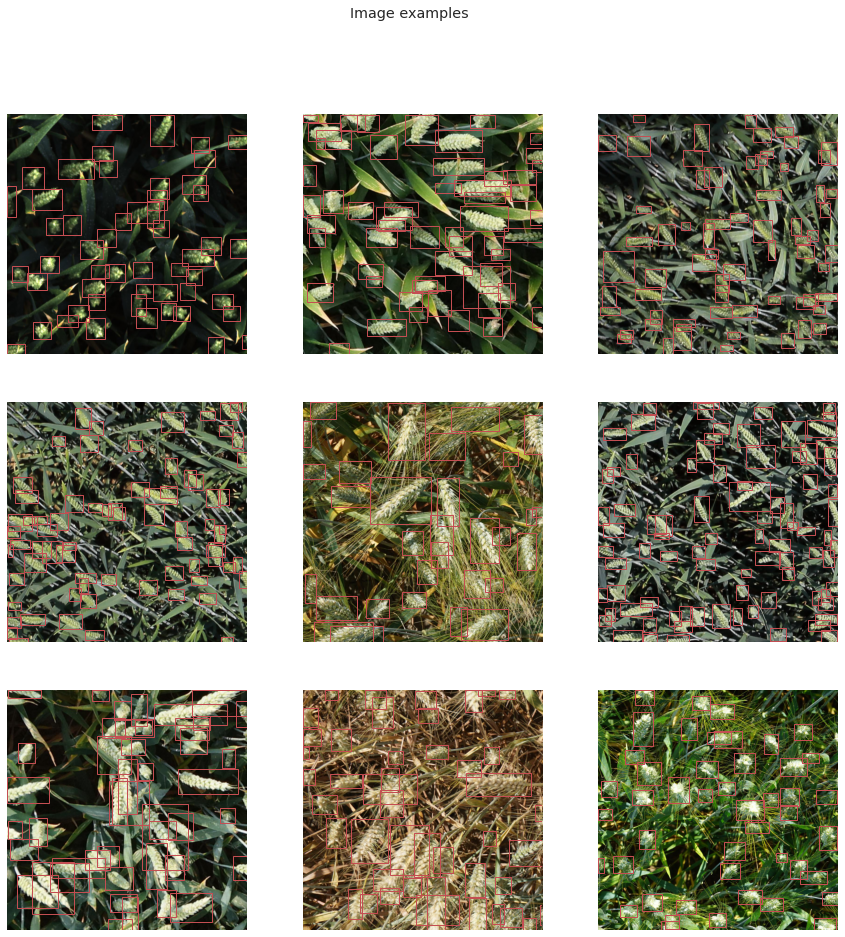

In [ ]:
display_images(training_images_dataframe, size=(15,15))

In [ ]:
training_images_dataframe['count'] = training_images_dataframe.apply(lambda row: 1 if np.isfinite(row.width) else 0, axis=1)
training_images_count = training_images_dataframe.groupby('image_id').count().reset_index()

In [ ]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Histogram(x=training_images_count['count'],
                           xbins = dict(size=4),
                           opacity=0.75,
                           marker_color='teal'))
fig.update_layout(bargap=0.1,
                  xaxis_title_text='Bins', # xaxis label
                  yaxis_title_text='Count', # yaxis label  
                  title=dict(text="Number of Wheat Heads per Image <br> <i>Most images have 20-50 wheat heads",
                        font_family ="Franklin Gothic",
                        font_size=25,
                        x=0.5)  
                  )

fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_traces(marker_line_color='black',
                  marker_line_width=2, opacity=0.7)
fig.update_layout(plot_bgcolor='pink')

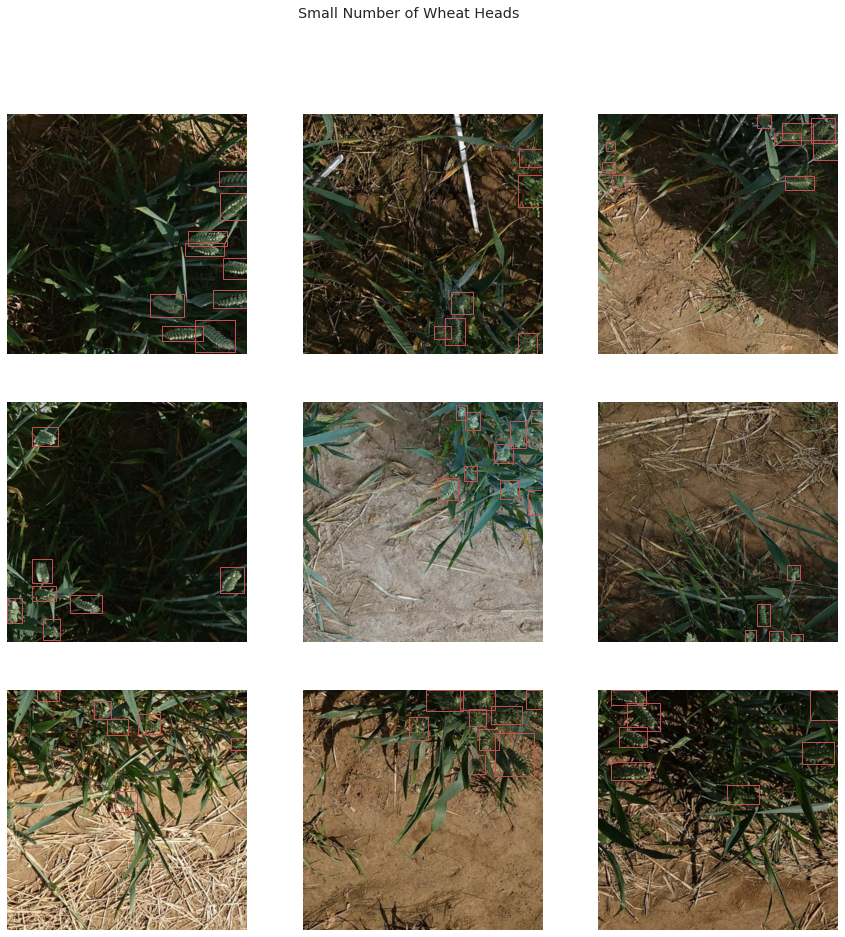

In [ ]:
# Images with less wheat heads
less_heads_ids = training_images_count[training_images_count['count'] < 10].image_id
display_images(training_images_dataframe[training_images_dataframe.image_id.isin(less_heads_ids)], title='Small Number of Wheat Heads')

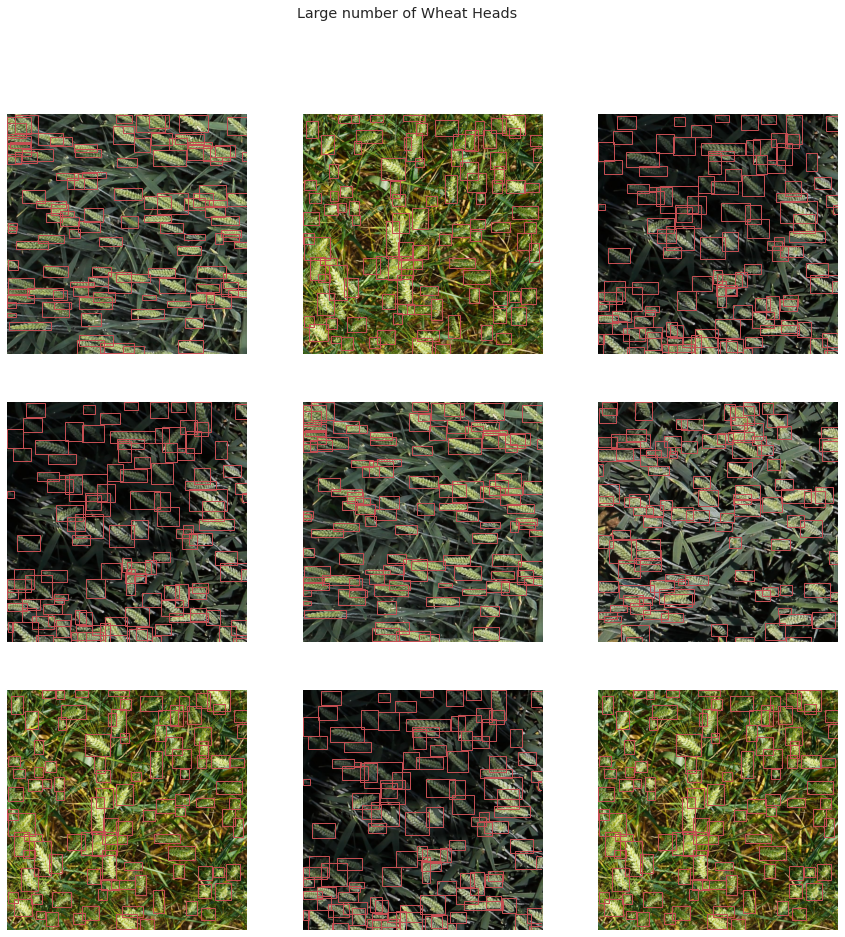

In [ ]:
# Images with more heads
many_heads_ids = training_images_count[training_images_count['count'] > 100].image_id
display_images(training_images_dataframe[training_images_dataframe.image_id.isin(many_heads_ids)], title='Large number of Wheat Heads ')

In [ ]:
# areas of bboxes
training_images_dataframe['bbox_area'] = training_images_dataframe['bbox_width'] * training_images_dataframe['bbox_height']

# compute the total bounding boxes area per image
area_per_image = training_images_dataframe.groupby(by='image_id').sum().reset_index()

# compute the percentage of the image area covered by bounding boxes
area_per_image_percentage = area_per_image.copy()
area_per_image_percentage['bbox_area'] = area_per_image_percentage['bbox_area'] / (1024*1024) * 100

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=area_per_image_percentage['bbox_area'],
                           xbins = dict(size=4),
                           opacity=0.75,
                           marker_color='mediumseagreen'))
fig.update_layout(bargap=0.1,
                  xaxis_title_text='Bins', # xaxis label
                  yaxis_title_text='Count', # yaxis label  
                  title=dict(text="Percentage of image area covered by bounding boxes"
                      "<br><i>20-40% of the image area is covered by the bounding boxes.</i>",
                        font_family ="Franklin Gothic",
                        font_size=25,
                        x=0.5)  
                  )

fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_traces(marker_line_color='black',
                  marker_line_width=2, opacity=0.7)
fig.update_layout(plot_bgcolor='pink')


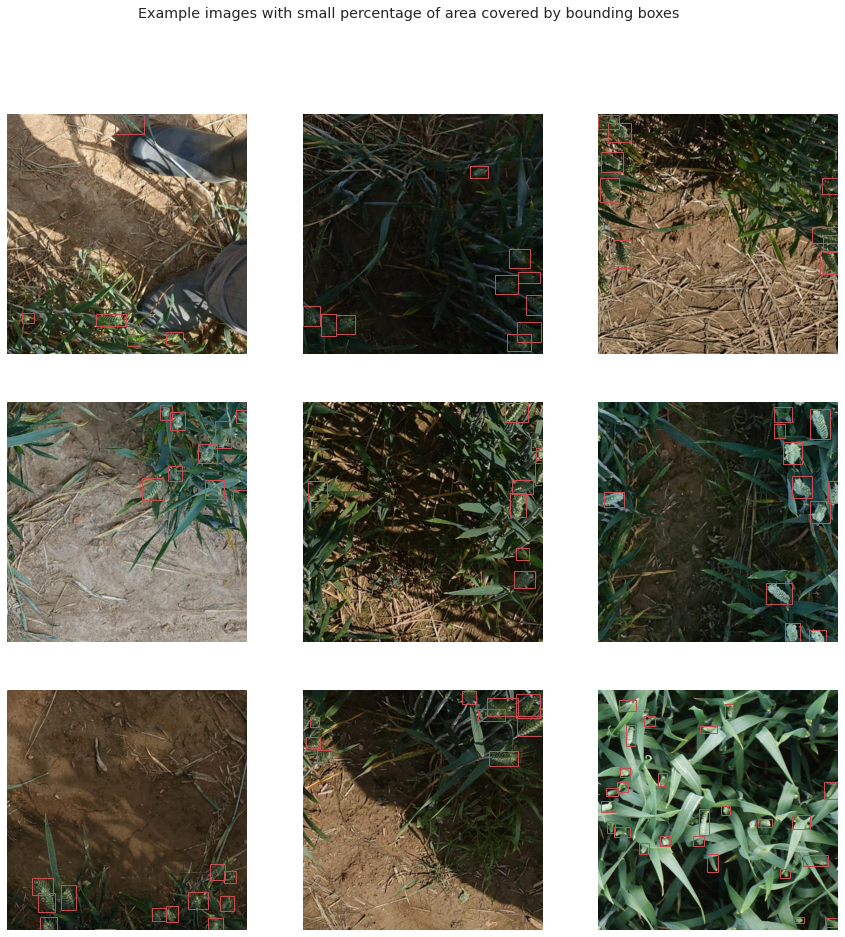

In [ ]:
small_area_perc_ids = area_per_image_percentage[area_per_image_percentage['bbox_area'] < 7].image_id
display_images(training_images_dataframe[training_images_dataframe.image_id.isin(small_area_perc_ids)], title='Example images with small percentage of area covered by bounding boxes')

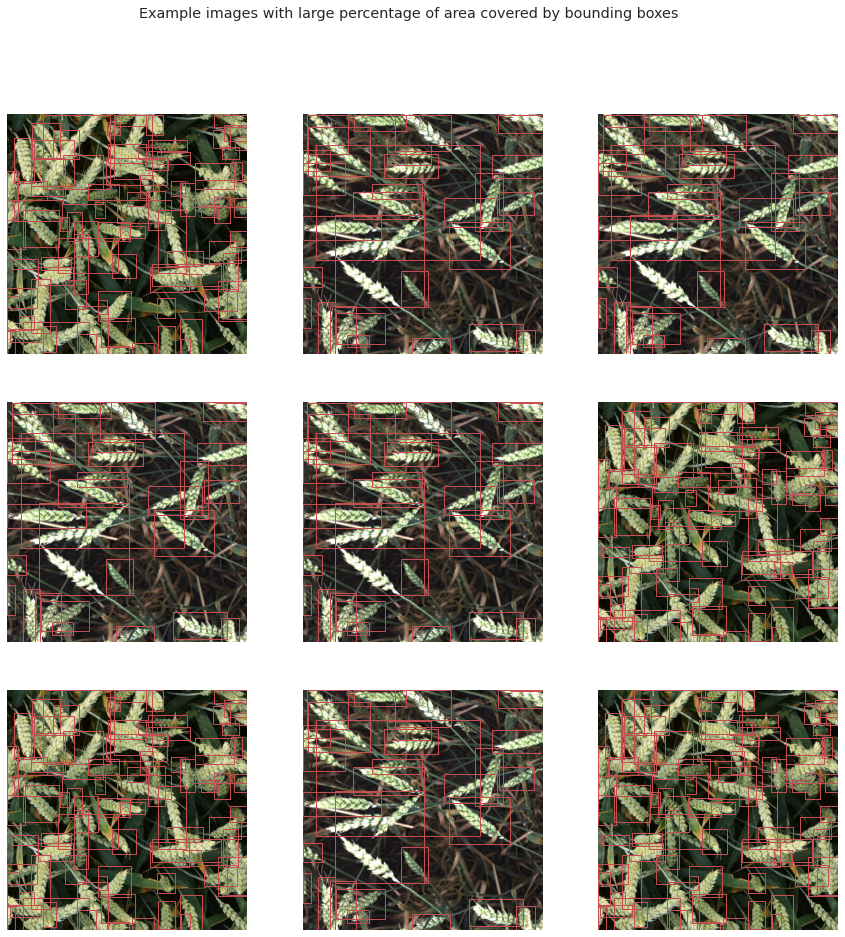

In [ ]:
large_area_perc_ids = area_per_image_percentage[area_per_image_percentage['bbox_area'] > 95].image_id
display_images(training_images_dataframe[training_images_dataframe.image_id.isin(large_area_perc_ids)], title='Example images with large percentage of area covered by bounding boxes')

In [ ]:
def get_image_brightness(image):
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # get average brightness
    return np.array(gray).mean()

def add_brightness(df):
    brightness = []
    for _, row in df.iterrows():
        img_id = row.image_id
        image = cv2.imread(train_dir + img_id + '.jpg')
        brightness.append(get_image_brightness(image))
        
    brightness_df = pd.DataFrame(brightness)
    brightness_df.columns = ['brightness']
    df = pd.concat([df, brightness_df], ignore_index=True, axis=1)
    df.columns = ['image_id', 'brightness']
    
    return df

In [ ]:
# add brightness to the dataframe
images_df = pd.DataFrame(training_images_dataframe.image_id.unique())
images_df.columns = ['image_id']
brightness_df = add_brightness(images_df)

training_images_dataframe = training_images_dataframe.merge(brightness_df, on='image_id')

In [ ]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=training_images_dataframe['brightness'],
                           xbins = dict(size=5),
                           opacity=0.75,
                           marker_color='darkgreen'))
fig.update_layout(bargap=0.1,
                  xaxis_title_text='Bins', # xaxis label
                  yaxis_title_text='Count', # yaxis label  
                  title=dict(text="Image Brightness Distribution",
                        font_family ="Franklin Gothic",
                        font_size=25,
                        x=0.5)  
                  )

fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
fig.update_traces(marker_line_color='black',
                  marker_line_width=2, opacity=0.7)
fig.update_layout(plot_bgcolor='pink')

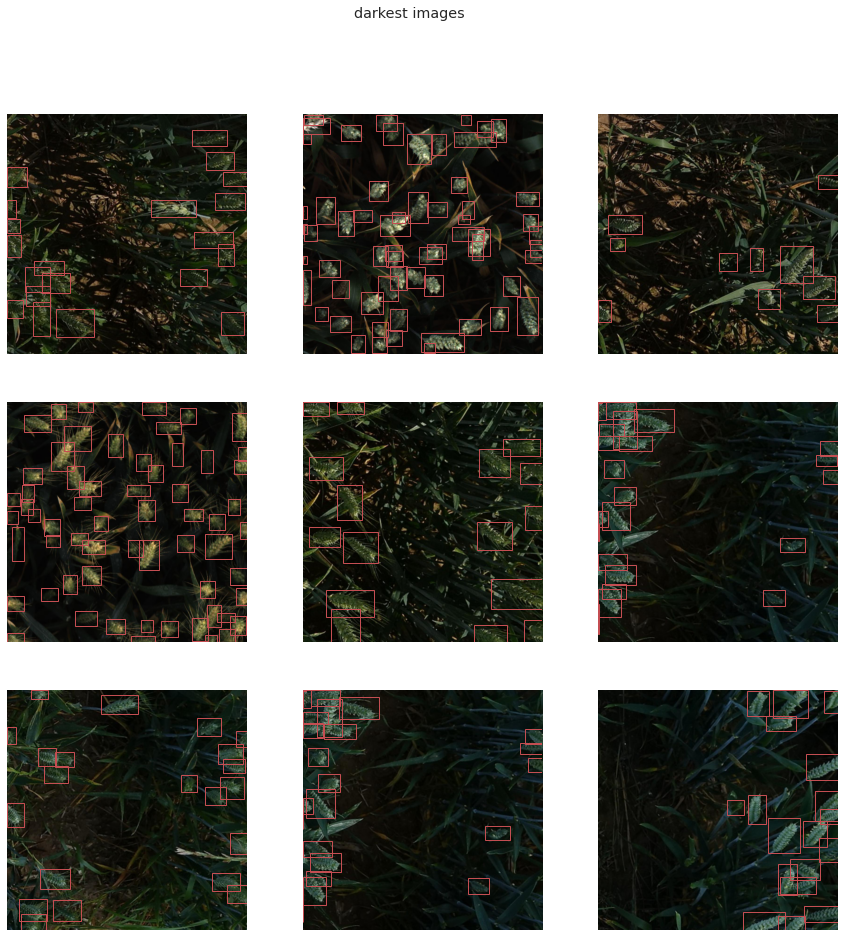

In [ ]:
# darkest images
dark_ids = training_images_dataframe[training_images_dataframe['brightness'] < 30].image_id
display_images(training_images_dataframe[training_images_dataframe.image_id.isin(dark_ids)], title="darkest images")

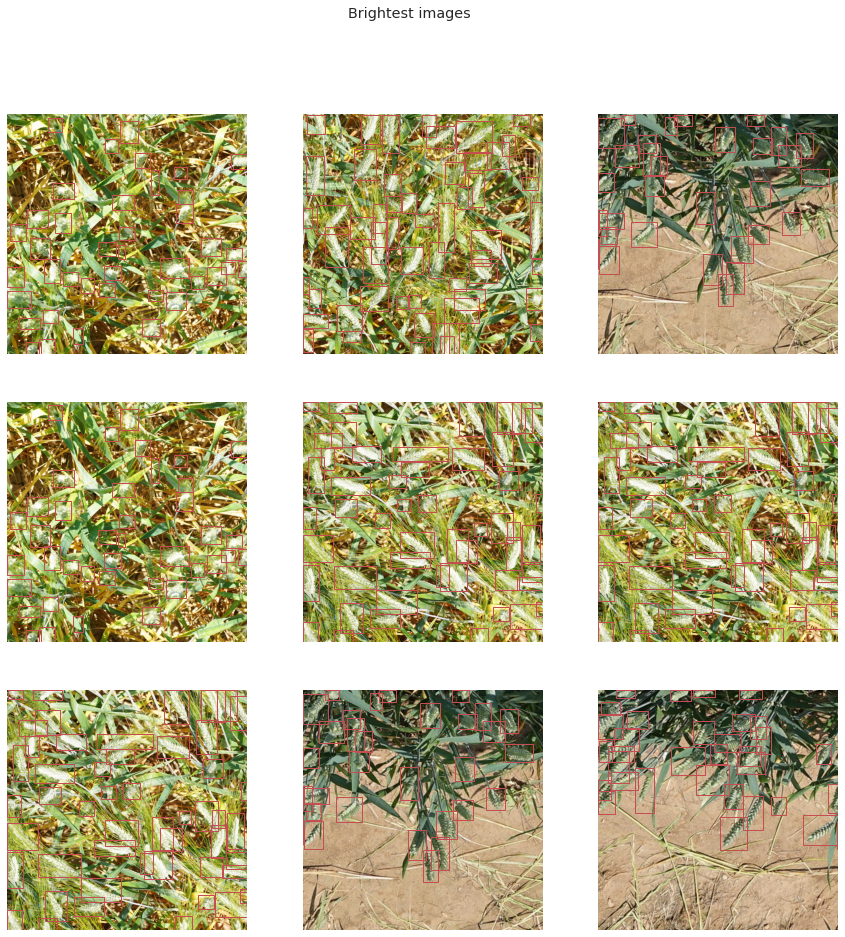

In [ ]:
# Brightest images
bright_ids = training_images_dataframe[training_images_dataframe['brightness'] > 130].image_id
display_images(training_images_dataframe[training_images_dataframe.image_id.isin(bright_ids)], title='Brightest images')

I would like to plot images with different dominant colors. The idea is that the most green images will represent healthy plants. The most yellow images will contain plants close to maturity. The most brown images will have ground on them.

In [ ]:
def get_percentage_of_green_pixels(image):
  # convert to HSV
  hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  
  # get the green mask
  hsv_lower = (40, 40, 40) 
  hsv_higher = (70, 255, 255)
  green_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
  
  return float(np.sum(green_mask)) / 255 / (1024 * 1024)

def get_percentage_of_yellow_pixels(image):
  # convert to HSV
  hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
  
  # get the green mask
  hsv_lower = (25, 40, 40)
  hsv_higher = (35, 255, 255)
  yellow_mask = cv2.inRange(hsv, hsv_lower, hsv_higher)
  
  return float(np.sum(yellow_mask)) / 255 / (1024 * 1024)

def add_green_pixels_percentage(df):
  green = []
  for _, row in df.iterrows():
    img_id = row.image_id
    image = cv2.imread(train_dir + img_id + '.jpg')
    green.append(get_percentage_of_green_pixels(image))
    
  green_df = pd.DataFrame(green)
  green_df.columns = ['green_pixels']
  df = pd.concat([df, green_df], ignore_index=True, axis=1)
  df.columns = ['image_id', 'green_pixels']
  
  return df

def add_yellow_pixels_percentage(df):
  yellow = []
  for _, row in df.iterrows():
    img_id = row.image_id
    image = cv2.imread(train_dir + img_id + '.jpg')
    yellow.append(get_percentage_of_yellow_pixels(image))
    
  yellow_df = pd.DataFrame(yellow)
  yellow_df.columns = ['yellow_pixels']
  df = pd.concat([df, yellow_df], ignore_index=True, axis=1)
  df.columns = ['image_id', 'yellow_pixels']
    
  return df

In [ ]:
# add a column with the percentage of green pixels
green_pixels_df = add_green_pixels_percentage(images_df)
training_images_dataframe = training_images_dataframe.merge(green_pixels_df, on='image_id')
# add a column with the percentage of yellow pixels
yellow_pixels_df = add_yellow_pixels_percentage(images_df)
training_images_dataframe = training_images_dataframe.merge(yellow_pixels_df, on='image_id')

In [ ]:
fig = make_subplots(rows =2,cols =1)

fig.add_trace(go.Histogram(x=training_images_dataframe['green_pixels_x'],
                           xbins = dict(size=0.01),
                           opacity=0.75,
                           name='green_pixels',
                           marker_color='green'),
                           row=1,
                           col=1)
fig.add_trace(go.Histogram(x=training_images_dataframe['yellow_pixels'],
                           xbins = dict(size=0.01),
                           opacity=0.75,
                           name='yellow_pixels',
                           marker_color='yellow'),
                           row=2,
                           col=1)
fig.update_layout(bargap=0.1,
                  title=dict(text="Percentage of Pixel Distribution",
                        font_family ="Franklin Gothic",
                        font_size=25,
                        x=0.5),
                  plot_bgcolor='pink'  
                  )

fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True,title='' ,row =1, col=1)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True,title='Count',row =1, col=1)
fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True,title='Pixel Percentage' ,row =2, col=1)
fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True,title='Count',row =2, col=1)
fig.update_traces(marker_line_color='black',
                  marker_line_width=2, opacity=0.7)





*Surprisingly, the most green images have only about 60% green pixels.*

*The majority of the images are not green at all! Most probably, they are more yellow and are the images of the plants close to harvest.*


## YOLO Label Creation

In [ ]:
# Importing libraries
import numpy as np
import random
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import warnings
import os
from glob import glob
import shutil
warnings.filterwarnings('ignore')

In [ ]:
# setup directory and files
base_dir = "/content/drive/My Drive/Dataset"
train_dataframe = os.path.join(base_dir, 'train.csv')
train_dir = os.path.join(base_dir, 'Train/')
data_dir = os.path.join(base_dir, 'Data/')
if not os.path.exists(data_dir):
  print("Directory Created")
  os.makedirs(data_dir)

In [ ]:
# Load dataframe
train_df = pd.read_csv(train_dataframe)

In [ ]:
train_df.head()

,image_id,width,height,bbox,source
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1


In [ ]:
# check for any null values
train_df.isnull().any().any()

False

In [ ]:
# check for any height and width is other than 1024
print((train_df['height'] != 1024).any())
print((train_df['width'] != 1024).any())

False
False


In [ ]:
# some information about data
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 147793 entries, 0 to 147792
Data columns (total 5 columns):
 #   Column    Non-Null Count   Dtype 
---  ------    --------------   ----- 
 0   image_id  147793 non-null  object
 1   width     147793 non-null  int64 
 2   height    147793 non-null  int64 
 3   bbox      147793 non-null  object
 4   source    147793 non-null  object
dtypes: int64(2), object(3)
memory usage: 5.6+ MB


In [ ]:
# create new dataframe with 2 columns image_id and bbox
img_bb = train_df[['image_id','bbox']]

In [ ]:
# converting string to list
img_bb['bbox'] = img_bb['bbox'].str.strip('][').str.split(',')
img_bb.head()

,image_id,bbox
0,b6ab77fd7,"[834.0, 222.0, 56.0, 36.0]"
1,b6ab77fd7,"[226.0, 548.0, 130.0, 58.0]"
2,b6ab77fd7,"[377.0, 504.0, 74.0, 160.0]"
3,b6ab77fd7,"[834.0, 95.0, 109.0, 107.0]"
4,b6ab77fd7,"[26.0, 144.0, 124.0, 117.0]"


In [ ]:
# define some new empty features
img_bb['x'] =''
img_bb['y'] =''
img_bb['w'] =''
img_bb['h'] =''
img_bb['xy_min'] = ''
img_bb['xy_max'] = ''
img_bb.head()

,image_id,bbox,x,y,w,h,xy_min,xy_max
0,b6ab77fd7,"[834.0, 222.0, 56.0, 36.0]",,,,,,
1,b6ab77fd7,"[226.0, 548.0, 130.0, 58.0]",,,,,,
2,b6ab77fd7,"[377.0, 504.0, 74.0, 160.0]",,,,,,
3,b6ab77fd7,"[834.0, 95.0, 109.0, 107.0]",,,,,,
4,b6ab77fd7,"[26.0, 144.0, 124.0, 117.0]",,,,,,


In [ ]:
# This loop will loop through whole data and update newly created features
%%time
for i in range(len(img_bb)):
  img_bb.iloc[i,1] = pd.to_numeric(img_bb.iloc[i,1], downcast='integer')
  img_bb.loc[i, 'x'] = img_bb.loc[i, 'bbox'][0]
  img_bb.loc[i, 'y'] = img_bb.loc[i, 'bbox'][1]
  img_bb.loc[i, 'w'] = img_bb.loc[i, 'bbox'][2]
  img_bb.loc[i, 'h'] = img_bb.loc[i, 'bbox'][3]
  img_bb.loc[i, 'xy_min'] = (int(img_bb.loc[i, 'x']), int(img_bb.loc[i, 'y']))
  img_bb.loc[i, 'xy_max'] = (int(img_bb.loc[i, 'x'] + img_bb.loc[i, 'w']), int(img_bb.loc[i, 'y'] + img_bb.loc[i, 'h']))
  if i % 3000 == 0:
    print('iter:' ,i)

iter: 0
iter: 3000
iter: 6000
iter: 9000
iter: 12000
iter: 15000
iter: 18000
iter: 21000
iter: 24000
iter: 27000
iter: 30000
iter: 33000
iter: 36000
iter: 39000
iter: 42000
iter: 45000
iter: 48000
iter: 51000
iter: 54000
iter: 57000
iter: 60000
iter: 63000
iter: 66000
iter: 69000
iter: 72000
iter: 75000
iter: 78000
iter: 81000
iter: 84000
iter: 87000
iter: 90000
iter: 93000
iter: 96000
iter: 99000
iter: 102000
iter: 105000
iter: 108000
iter: 111000
iter: 114000
iter: 117000
iter: 120000
iter: 123000
iter: 126000
iter: 129000
iter: 132000
iter: 135000
iter: 138000
iter: 141000
iter: 144000
iter: 147000
CPU times: user 5min 12s, sys: 17.3 s, total: 5min 29s
Wall time: 5min 2s


In [ ]:
# lets check our work
img_bb.head()

,image_id,bbox,x,y,w,h,xy_min,xy_max
0,b6ab77fd7,"[834, 222, 56, 36]",834,222,56,36,"(834, 222)","(890, 258)"
1,b6ab77fd7,"[226, 548, 130, 58]",226,548,130,58,"(226, 548)","(356, 606)"
2,b6ab77fd7,"[377, 504, 74, 160]",377,504,74,160,"(377, 504)","(451, 664)"
3,b6ab77fd7,"[834, 95, 109, 107]",834,95,109,107,"(834, 95)","(943, 202)"
4,b6ab77fd7,"[26, 144, 124, 117]",26,144,124,117,"(26, 144)","(150, 261)"


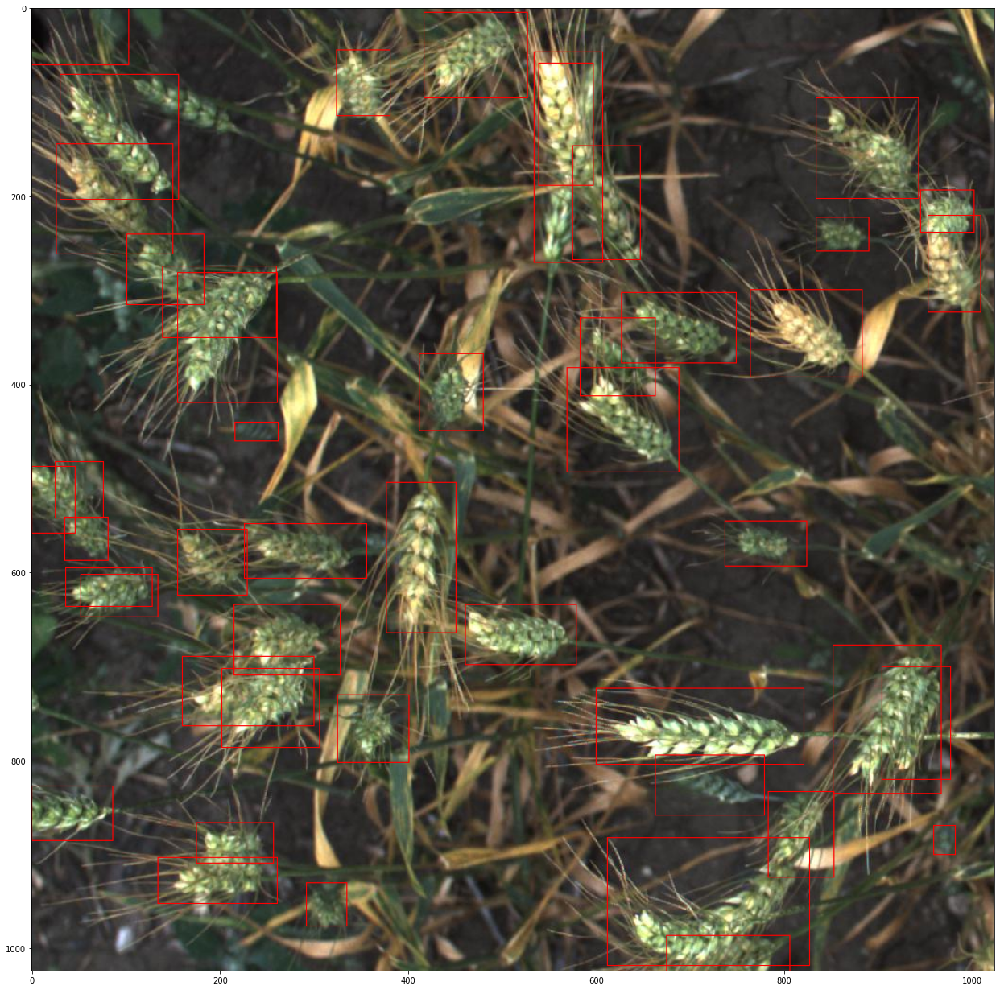

In [ ]:
# checking bounding box with one image
check_img_id = img_bb.loc[0,'image_id']
img = cv2.imread(train_dir + check_img_id +'.jpg')
rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
for i in range(len(img_bb[img_bb['image_id'] == check_img_id])):
  rec = cv2.rectangle(rgb_img, img_bb.loc[i,'xy_min'], img_bb.loc[i,'xy_max'], (255,0,0), 1, 1)
plt.figure(figsize = (22,22))
plt.imshow(rgb_img)

In [ ]:
image_id_list = train_df['image_id'].unique()
len(image_id_list)

3373

In [ ]:
train_dir_images_list = os.listdir(train_dir)
print('Number of images without label: {}'.format(len(train_dir_images_list) - len(image_id_list)))

Number of images without label: 49


Making blank {image_id}.txt files

In [ ]:
# because 49 images dont have labels and it will cuase error while training  
for img in train_dir_images_list:
  f  = open(data_dir + img[:-4] + ".txt", "w")
  f.close()

Now loop though all .txt files to fill with labels

In [ ]:
label = pd.DataFrame()

In [ ]:
# This loop will generate center_x, center_y and width and height feature and write it in {image_id}.txt in yolo format

%%time
for j , id in enumerate(image_id_list):
  temp_df = train_df[train_df['image_id']== id][['image_id','bbox']]
  temp_df['bbox'] = temp_df['bbox'].str.strip('][').str.split(',')
  temp_df['x_min'] =''
  temp_df['y_min'] =''
  temp_df['w'] =''
  temp_df['h'] =''
  temp_df['x_center'] = ''
  temp_df['y_center'] = ''
  temp_df['yolo_w'] =''
  temp_df['yolo_h'] =''
  f  = open(data_dir + id + ".txt", "w+")
  for i in temp_df.index:
    temp_df.loc[i,'bbox'] = pd.to_numeric(temp_df.loc[i,'bbox'],downcast='integer')
    temp_df.loc[i,'x_min'] = temp_df.loc[i,'bbox'][0]
    temp_df.loc[i,'y_min'] = temp_df.loc[i,'bbox'][1]
    temp_df.loc[i,'w'] = temp_df.loc[i,'bbox'][2]
    temp_df.loc[i,'h'] = temp_df.loc[i,'bbox'][3]
    temp_df.loc[i,'x_center'] = np.round((temp_df.loc[i,'x_min'] + int(temp_df.loc[i,'w']/2))/1024,6)
    temp_df.loc[i,'y_center'] = np.round((temp_df.loc[i,'y_min'] + int(temp_df.loc[i,'h']/2))/1024,6)
    temp_df.loc[i,'yolo_w'] = np.round(temp_df.loc[i,'w']/1024,6)
    temp_df.loc[i,'yolo_h'] = np.round(temp_df.loc[i,'h']/1024,6)
    f.write(str(0)+' '+str(temp_df.loc[i,'x_center'])+' ' +str(temp_df.loc[i,'y_center'])+' '+str(temp_df.loc[i,'yolo_w'])+' '+str(temp_df.loc[i,'yolo_h'])+'\n')
  
  f.close()
  label = label.append(temp_df)

CPU times: user 8min 15s, sys: 11.5 s, total: 8min 27s
Wall time: 8min 48s


In [ ]:
label.head()

,image_id,bbox,x_min,y_min,w,h,x_center,y_center,yolo_w,yolo_h
0,b6ab77fd7,"[834, 222, 56, 36]",834,222,56,36,0.841797,0.234375,0.054688,0.035156
1,b6ab77fd7,"[226, 548, 130, 58]",226,548,130,58,0.28418,0.563477,0.126953,0.056641
2,b6ab77fd7,"[377, 504, 74, 160]",377,504,74,160,0.404297,0.570312,0.072266,0.15625
3,b6ab77fd7,"[834, 95, 109, 107]",834,95,109,107,0.867188,0.144531,0.106445,0.104492
4,b6ab77fd7,"[26, 144, 124, 117]",26,144,124,117,0.085938,0.197266,0.121094,0.114258


In [ ]:
# Expected length should be 3422 one txt file for each image
print("Length of data folder we created is: {}".format(len(glob(data_dir + "*"))))

Length of data folder we created is: 3422


we need to move all images to data directory where we have all labels ready.

In [ ]:
%%time
files = os.listdir(train_dir)
for f in files:
  shutil.copy(train_dir + "/" + f, data_dir)

CPU times: user 2.25 s, sys: 2.55 s, total: 4.8 s
Wall time: 32 s


In [ ]:
# Expected length should be 3422*2 = 6844
print("Length of label folder we created is: {}".format(len(glob(data_dir + "*"))))

Length of label folder we created is: 6844


Now we need to create train.txt file which has all images name.

In [ ]:
image_files = []
for filename in os.listdir(data_dir):
  if filename.endswith(".jpg"):
    image_files.append(data_dir + filename)

with open(base_dir + "/train.txt", "w") as outfile:
  for image in image_files:
    outfile.write(image)
    outfile.write("\n")
  outfile.close()

Creating a directory to store validation set. 

In [ ]:
os.makedirs("/content/drive/MyDrive/Dataset/Data_Val")

Moving a fraction of image files and label to the validation directory

In [ ]:
val_img=[]
val_label=[]
for file in os.listdir(data_dir):
    if file.endswith(".jpg"):
        val_img.append(file)
    if file.endswith(".txt"):
        val_label.append(file)

source="/content/drive/MyDrive/Dataset/Data"
destination="/content/drive/MyDrive/Dataset/Data_Val"

for filename in random.sample(val_img, int(len(val_img)*.2)):
    shutil.move(source + "/" + filename, destination)
    shutil.move(source + "/" + filename[:-4]+".txt",destination)

# YOLO V5

In [17]:
import pandas as pd
import tensorflow as tf
import yaml
import os
from sklearn import model_selection
import numpy as np
import shutil #used for file copying
from tqdm import tqdm #Tqdm  for progress bars with python 

In [3]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt  # install dependencies

import torch
from IPython.display import Image, clear_output  # to display images

clear_output()
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Setup complete. Using torch 1.8.1+cu101 (Tesla T4)


In [4]:
!pip install -U PyYAML

Requirement already up-to-date: PyYAML in /usr/local/lib/python3.7/dist-packages (5.4.1)


In [7]:
!touch wheat.yaml

In [8]:
 !python train.py --img 1024 --data wheat.yaml --cfg yolov5s.yaml --weights 'yolov5s.pt' --batch-size 8 --epochs 100 --name wheat_model

github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-197-gd808855 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Namespace(adam=False, artifact_alias='latest', batch_size=8, bbox_interval=-1, bucket='', cache_images=False, cfg='./models/yolov5s.yaml', data='wheat.yaml', device='', entity=None, epochs=100, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[1024, 1024], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='wheat_model', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/wheat_model', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=8, upload_dataset=False, weights='yolov5s.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
2021-06-16 13:32:57.864718: I tensorflow/stream_executor/platform/default/dso_loader

In [18]:
%cd yolov5

/content/yolov5


In [12]:
!python detect.py --weights runs/train/wheat_model/weights/best.pt --img 1024 --conf 0.5 --source /content/drive/MyDrive/Dataset/Test

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.5, device='', exist_ok=False, half=False, hide_conf=False, hide_labels=False, imgsz=1024, iou_thres=0.45, line_thickness=3, max_det=1000, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='/content/drive/MyDrive/Dataset/Test', update=False, view_img=False, weights=['/content/yolov5/runs/train/wheat_model/weights/best.pt'])
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v5.0-197-gd808855 torch 1.8.1+cu101 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
Model Summary: 224 layers, 7053910 parameters, 0 gradients, 16.3 GFLOPs
image 1/10 /content/drive/MyDrive/Dataset/Test/2fd875eaa.jpg: 1024x1024 28 wheats, Done. (0.029s)
image 2/10 /content/drive/MyDrive/Dataset/Test/348a992bb.jpg: 1024x1024 35 wheats, Done. (0.028s)
image 3/10 /content/drive/MyDrive/Dataset/Test/51b3e36ab.jpg: 1024x1024 20 wheats, Done. (0.028s)
image 4/10 /content/dr

In [24]:
from utils.plots import plot_results 
plot_results(save_dir='/content/yolov5/runs/train/wheat_model') 